<a href="https://colab.research.google.com/github/mileslilly2/code_as_tool/blob/main/morgantown_dem_clip_greyscale_png.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# ─────────────────────────────────────────────
# 1. Install GDAL and set up directories
# ─────────────────────────────────────────────
!apt-get -y -qq install gdal-bin python3-gdal
from pathlib import Path
import urllib.request, zipfile, subprocess, json

ROOT      = Path("/content")
TIF_DIR   = ROOT / "tifs"
SHAPE_DIR = ROOT / "clip_shape"
TIF_DIR.mkdir(exist_ok=True)
SHAPE_DIR.mkdir(exist_ok=True)


Selecting previously unselected package python3-numpy.
(Reading database ... 126333 files and directories currently installed.)
Preparing to unpack .../python3-numpy_1%3a1.21.5-1ubuntu22.04.1_amd64.deb ...
Unpacking python3-numpy (1:1.21.5-1ubuntu22.04.1) ...
Selecting previously unselected package python3-gdal.
Preparing to unpack .../python3-gdal_3.6.4+dfsg-1~jammy0_amd64.deb ...
Unpacking python3-gdal (3.6.4+dfsg-1~jammy0) ...
Selecting previously unselected package gdal-bin.
Preparing to unpack .../gdal-bin_3.6.4+dfsg-1~jammy0_amd64.deb ...
Unpacking gdal-bin (3.6.4+dfsg-1~jammy0) ...
Setting up python3-numpy (1:1.21.5-1ubuntu22.04.1) ...
Setting up python3-gdal (3.6.4+dfsg-1~jammy0) ...
Setting up gdal-bin (3.6.4+dfsg-1~jammy0) ...
Processing triggers for man-db (2.10.2-1) ...


In [ ]:
!pip install rasterio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 78.5 MB/s eta 0:00:00


In [ ]:
# ============================================
# Colab Notebook to Download Two GeoTIFF DEM Files
# ============================================

import os
from pathlib import Path
import urllib.request

# Set output directory
output_dir = Path("/content/tifs")
output_dir.mkdir(exist_ok=True)

# List of DEM URLs
urls = [
    "https://data.wvgis.wvu.edu/pub/Clearinghouse/elevation/3MeterDEM_SAMB_2003_utm83/tiff/morgantown_north_wv_pa_USGSAndSAMB_2003_utm83.tif",
    "https://data.wvgis.wvu.edu/pub/Clearinghouse/elevation/3MeterDEM_SAMB_2003_utm83/tiff/morgantown_south_wv_USGSAndSAMB_2003_utm83.tif"
]

# Download each file
for url in urls:
    filename = url.split("/")[-1]
    download_path = output_dir / filename
    print(f"Downloading {filename}...")
    urllib.request.urlretrieve(url, download_path)
    print(f"✅ Downloaded: {download_path}")


✅ Downloaded: /content/tifs/morgantown_north_wv_pa_USGSAndSAMB_2003_utm83.tif
✅ Downloaded: /content/tifs/morgantown_south_wv_USGSAndSAMB_2003_utm83.tif


In [ ]:
# ============================================
# Download and Unzip Morgantown Wards Shapefile
# ============================================

import zipfile

# Set shapefile download URL
shapefile_url = "https://data.wvgis.wvu.edu/pub/Clearinghouse/boundaries/morgantownWards_200601_wvSPnNAD83.zip"

# Download location
shapefile_zip_path = output_dir / "morgantown_wards.zip"

# Download the zip file
print("Downloading Morgantown Wards shapefile...")
urllib.request.urlretrieve(shapefile_url, shapefile_zip_path)
print(f"✅ Downloaded shapefile ZIP: {shapefile_zip_path}")

# Unzip it
with zipfile.ZipFile(shapefile_zip_path, "r") as zip_ref:
    zip_ref.extractall(output_dir / "morgantown_wards")
print(f"✅ Extracted shapefiles to: {output_dir / 'morgantown_wards'}")


✅ Downloaded shapefile ZIP: /content/tifs/morgantown_wards.zip
✅ Extracted shapefiles to: /content/tifs/morgantown_wards


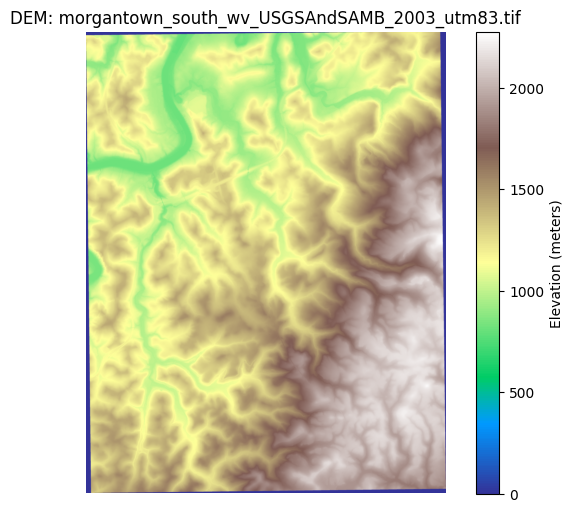

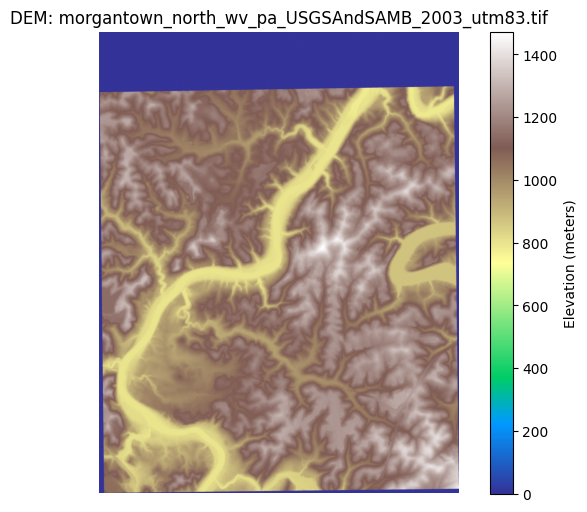

In [ ]:
# ============================================
# Visualize the DEM GeoTIFF Files
# ============================================

import rasterio
import matplotlib.pyplot as plt

# Find and plot all .tif files in the dem_data directory
dem_paths = list(output_dir.glob("*.tif"))

for path in dem_paths:
    with rasterio.open(path) as src:
        data = src.read(1)
        plt.figure(figsize=(8, 6))
        plt.imshow(data, cmap='terrain')
        plt.colorbar(label='Elevation (meters)')
        plt.title(f"DEM: {path.name}")
        plt.axis("off")
        plt.show()


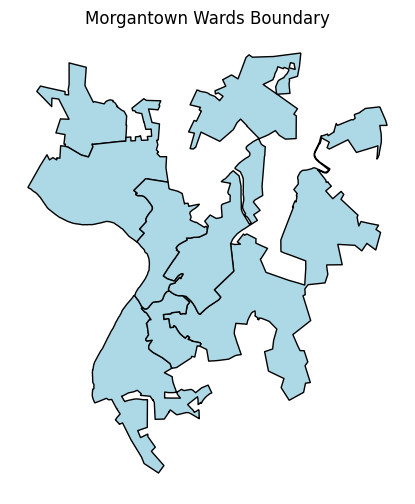

In [ ]:
# ============================================
# Visualize the Morgantown Wards Shapefile
# ============================================

import geopandas as gpd

# Load the shapefile
shapefile_dir = output_dir / "morgantown_wards"
shp_path = next(shapefile_dir.glob("*.shp"))

gdf = gpd.read_file(shp_path)

# Plot it
gdf.plot(figsize=(8, 6), edgecolor="black", facecolor="lightblue")
plt.title("Morgantown Wards Boundary")
plt.axis("off")
plt.show()


In [ ]:
# ============================================
# Merge the Two DEM GeoTIFF Files
# ============================================

from rasterio.merge import merge
from rasterio.plot import show
import rasterio

# List DEM files
dem_paths = list(output_dir.glob("*.tif"))

# Open the DEMs
src_files_to_mosaic = [rasterio.open(path) for path in dem_paths]

# Merge
mosaic, out_transform = merge(src_files_to_mosaic)

# Copy metadata and update
out_meta = src_files_to_mosaic[0].meta.copy()
out_meta.update({
    "driver": "GTiff",
    "height": mosaic.shape[1],
    "width": mosaic.shape[2],
    "transform": out_transform
})

# Output path
merged_path = output_dir / "morgantown_merged_dem.tif"

# Save merged raster
with rasterio.open(merged_path, "w", **out_meta) as dest:
    dest.write(mosaic)

print(f"✅ Merged DEM saved to: {merged_path}")


✅ Merged DEM saved to: /content/tifs/morgantown_merged_dem.tif


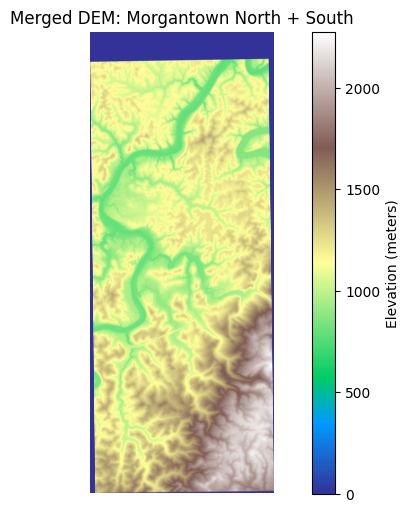

In [ ]:
# ============================================
# Visualize the Merged DEM GeoTIFF
# ============================================

# Reopen and visualize the merged raster
with rasterio.open(merged_path) as src:
    data = src.read(1)

plt.figure(figsize=(10, 6))
plt.imshow(data, cmap="terrain")
plt.colorbar(label="Elevation (meters)")
plt.title("Merged DEM: Morgantown North + South")
plt.axis("off")
plt.show()


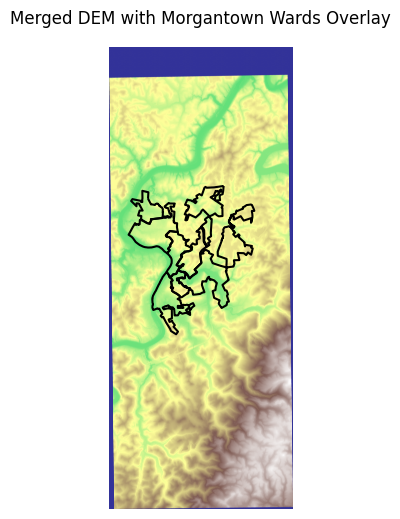

In [ ]:
# ============================================
# Overlay Shapefile on Top of Merged DEM
# ============================================

import geopandas as gpd
from rasterio.plot import show
from shapely.geometry import box

# Load the shapefile
gdf = gpd.read_file(shp_path)

# Reproject shapefile to match DEM CRS if needed
with rasterio.open(merged_path) as src:
    raster_crs = src.crs

if gdf.crs != raster_crs:
    gdf = gdf.to_crs(raster_crs)

# Plot DEM with shapefile overlay
with rasterio.open(merged_path) as src:
    fig, ax = plt.subplots(figsize=(10, 6))
    show((src, 1), ax=ax, cmap='terrain')
    gdf.boundary.plot(ax=ax, edgecolor='black', linewidth=1.5)
    ax.set_title("Merged DEM with Morgantown Wards Overlay")
    ax.axis("off")
    plt.show()


In [ ]:
# ============================================
# Clip the Merged DEM to the Morgantown Wards Shapefile
# ============================================

from rasterio.mask import mask

# Reload shapefile and ensure it matches DEM CRS
gdf = gpd.read_file(shp_path)
with rasterio.open(merged_path) as src:
    raster_crs = src.crs

if gdf.crs != raster_crs:
    gdf = gdf.to_crs(raster_crs)

# Get geometry as GeoJSON-like dict
geoms = gdf.geometry.values
geometry = [geom.__geo_interface__ for geom in geoms]

# Clip
with rasterio.open(merged_path) as src:
    out_image, out_transform = mask(src, geometry, crop=True)
    out_meta = src.meta.copy()

# Update metadata
out_meta.update({
    "driver": "GTiff",
    "height": out_image.shape[1],
    "width": out_image.shape[2],
    "transform": out_transform
})

# Save clipped raster
clipped_path = output_dir / "morgantown_clipped_dem.tif"
with rasterio.open(clipped_path, "w", **out_meta) as dest:
    dest.write(out_image)

print(f"✅ Clipped DEM saved to: {clipped_path}")


✅ Clipped DEM saved to: /content/tifs/morgantown_clipped_dem.tif


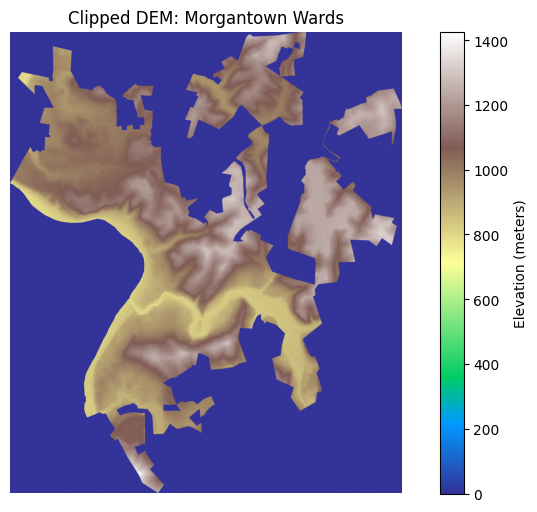

In [ ]:
# ============================================
# Visualize the Clipped DEM
# ============================================

with rasterio.open(clipped_path) as src:
    data = src.read(1)

plt.figure(figsize=(10, 6))
plt.imshow(data, cmap="terrain")
plt.colorbar(label="Elevation (meters)")
plt.title("Clipped DEM: Morgantown Wards")
plt.axis("off")
plt.show()


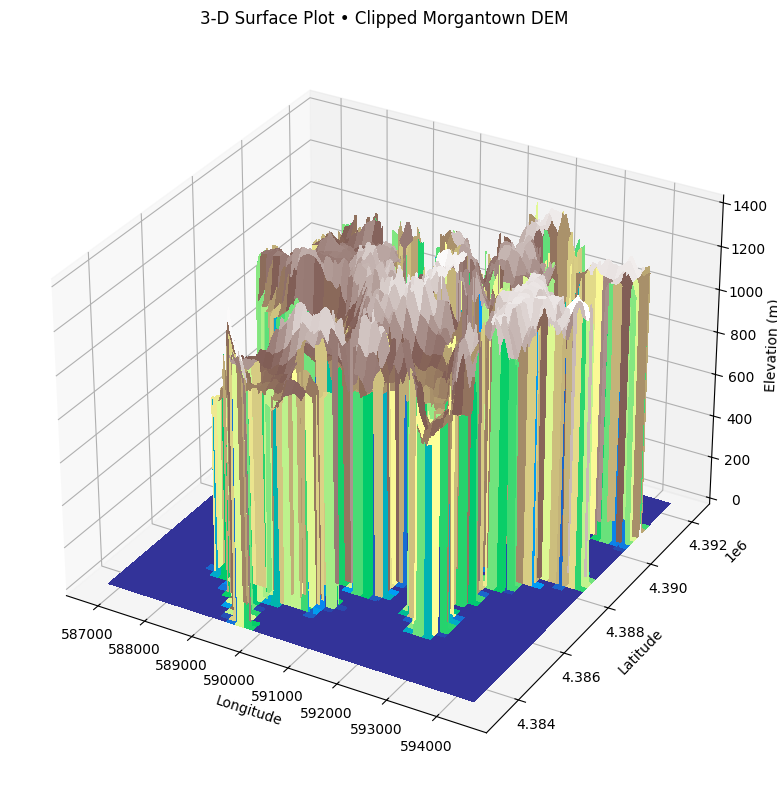

In [ ]:
# ============================================
# 3‑D Surface Plot of Clipped DEM  (shape‑safe)
# ============================================

from mpl_toolkits.mplot3d import Axes3D     # noqa: F401
import numpy as np
import matplotlib.pyplot as plt

stride = 10        # ↑=faster & coarser, ↓=slower & finer

with rasterio.open(clipped_path) as src:
    dem_full   = src.read(1)
    transform  = src.transform
    nodata_val = src.nodata

# --- build down‑sampled index grids (row, col) ---
rows = np.arange(0, dem_full.shape[0], stride)
cols = np.arange(0, dem_full.shape[1], stride)
row_idx, col_idx = np.meshgrid(rows, cols, indexing="ij")  # both (R,C)

# --- down‑sampled DEM ---
dem_ds = dem_full[row_idx, col_idx]
dem_ds = np.ma.masked_equal(dem_ds, nodata_val)

# --- compute map coordinates for every grid node ---
# For north‑up rasters:  x = c + (col + 0.5)*a,  y = f + (row + 0.5)*e
a, b, c, d, e, f = transform[:6]
X = c + (col_idx + 0.5) * a + (row_idx + 0.5) * b   # (R,C)
Y = f + (col_idx + 0.5) * d + (row_idx + 0.5) * e   # (R,C)

# --- plot ---
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection="3d")
ax.plot_surface(X, Y, dem_ds,
                cmap="terrain",
                linewidth=0, antialiased=False)

ax.set_title("3‑D Surface Plot • Clipped Morgantown DEM")
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
ax.set_zlabel("Elevation (m)")
plt.tight_layout()
plt.show()


✅ Saved:
  GIF → /content/morgantown_zoom_pan_spin.gif
  MP4 → /content/morgantown_zoom_pan_spin.mp4


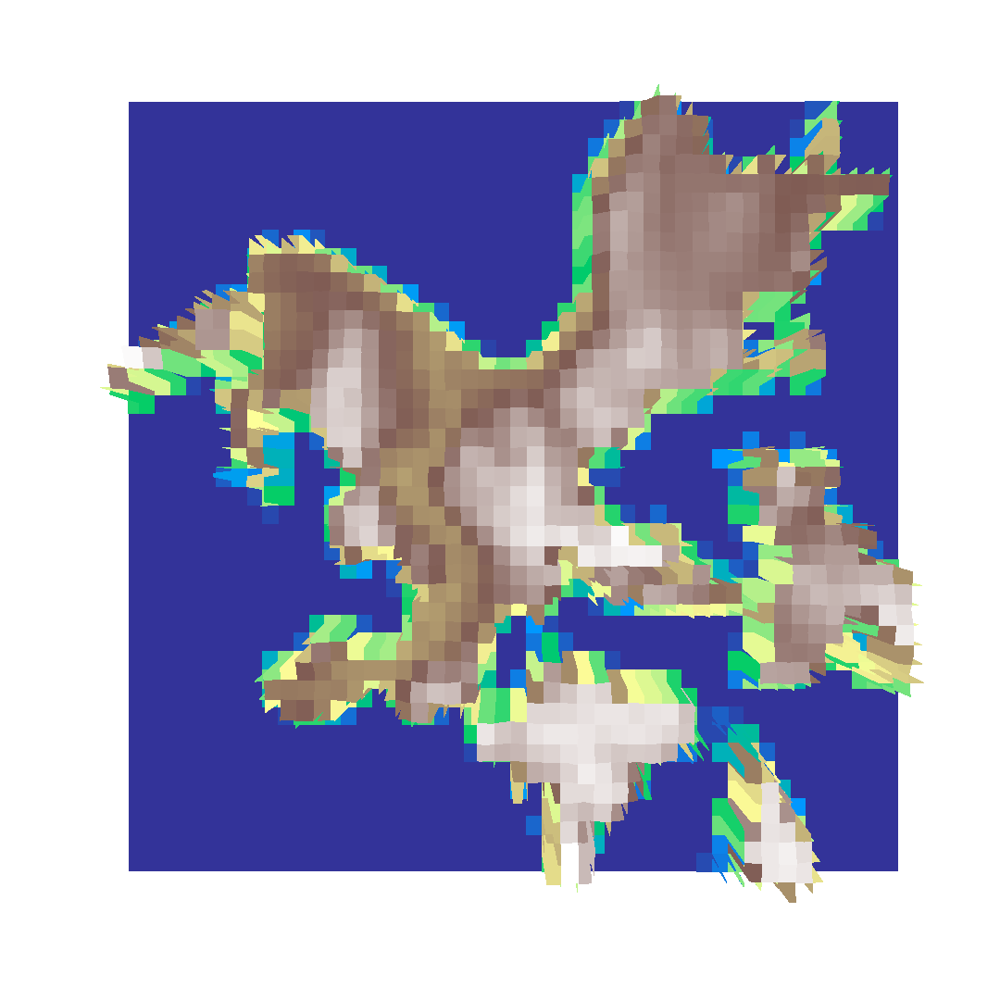

In [ ]:
# ============================================
# Pan‑Down → 360° Rotate → Pan‑Up  •  Zoom‑in GIF + MP4
# ============================================
import numpy as np, matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D             # noqa: F401
from matplotlib import animation
import rasterio, os

# ── tunables ───────────────────────────────────────────────
stride        = 10      # DEM down‑sample
zoom_factor   = 1.25   # 2× zoom‑in  (larger ⇒ tighter crop)
fps           = 24
hold_secs     = 2
n_pan, n_spin = 40, 120
fig_px        = 1080    # 1080×1080 square output
dpi           = 150     # fig inches = fig_px / dpi
# -----------------------------------------------------------

# ── DEM (down‑sampled) ─────────────────────────────────────
with rasterio.open(clipped_path) as src:
    dem = src.read(1)
    a, b, c, d, e, f = src.transform[:6]
    rows = np.arange(0, dem.shape[0], stride)
    cols = np.arange(0, dem.shape[1], stride)
    R, C = np.meshgrid(rows, cols, indexing="ij")
    Z = np.ma.masked_equal(dem[R, C], src.nodata)
    X = c + (C + 0.5) * a + (R + 0.5) * b
    Y = f + (C + 0.5) * d + (R + 0.5) * e

# ── crop extents to zoom in ────────────────────────────────
x_mid, y_mid = X.mean(), Y.mean()
x_rng, y_rng = (X.max() - X.min()) / zoom_factor, (Y.max() - Y.min()) / zoom_factor
x_lim = (x_mid - x_rng / 2, x_mid + x_rng / 2)
y_lim = (y_mid - y_rng / 2, y_mid + y_rng / 2)

# ── camera path (includes overhead holds) ──────────────────
n_hold = int(fps * hold_secs)
elev_seq = np.concatenate([
    np.full(n_hold, 90),
    np.linspace(90, 30, n_pan, endpoint=False),
    np.full(n_spin, 30),
    np.linspace(30, 90, n_pan, endpoint=False),
    np.full(n_hold, 90)
])
azim_seq = np.concatenate([
    np.zeros(n_hold),
    np.zeros(n_pan),
    np.linspace(0, 360, n_spin, endpoint=False),
    np.zeros(n_pan) + 360,
    np.zeros(n_hold) + 360
])
n_frames = elev_seq.size

# ── figure & animation ─────────────────────────────────────
# -- figure & animation ---------------------------------------------------
fig_in  = fig_px / dpi

fig     = plt.figure(figsize=(fig_in, fig_in), dpi=dpi)

ax = fig.add_axes([0, 0, 1, 1], projection="3d")
ax.plot_surface(X, Y, Z, cmap="terrain", linewidth=0, antialiased=False)
ax.set_xlim(x_lim); ax.set_ylim(y_lim)
ax.set_zlim(Z.min(), Z.max())
ax.set_axis_off()

def update(i):
    ax.view_init(elev=elev_seq[i], azim=azim_seq[i])
    return []

anim = animation.FuncAnimation(fig, update, frames=n_frames,
                               interval=1000 / fps)

# ── write GIF & MP4 ────────────────────────────────────────
gif_path  = "/content/morgantown_zoom_pan_spin.gif"
mp4_path  = "/content/morgantown_zoom_pan_spin.mp4"

anim.save(gif_path, writer="pillow", fps=fps, dpi=dpi)

anim.save(mp4_path, writer="ffmpeg", fps=fps,
          extra_args=["-pix_fmt", "yuv420p", "-crf", "18"])  # high‑quality MP4
plt.close(fig)

print("✅ Saved:")
print("  GIF →", gif_path)
print("  MP4 →", mp4_path)

from IPython.display import Image, Video
Image(gif_path)   # inline preview


In [ ]:
from google.colab import files

files.download(gif_path)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# ============================================
# GeoTIFF DEM ➜ 8‑bit & 16‑bit grayscale PNGs
# ============================================
import rasterio
import numpy as np
from PIL import Image
from pathlib import Path

# --- input & output -------------------------------------------------------
tif_path = clipped_path                         # or merged_path, etc.
base     = Path("/content") / tif_path.stem     # /content/morgantown_clipped_dem
out_8    = base.with_name(f"{tif_path.stem}_8bit.png")
out_16   = base.with_name(f"{tif_path.stem}_16bit.png")

with rasterio.open(tif_path) as src:
    dem  = src.read(1).astype(np.float32)
    mask = dem == src.nodata

# --- rescale to 0‑255 / 0‑65535 ------------------------------------------
valid   = dem[~mask]
z_min, z_max = valid.min(), valid.max()
scale   = np.clip((dem - z_min) / (z_max - z_min), 0, 1)

png_8   = (scale * 255   ).astype(np.uint8)
png_16  = (scale * 65535 ).astype(np.uint16)
png_8[mask]  = 0
png_16[mask] = 0

# --- write PNGs -----------------------------------------------------------
Image.fromarray(png_8,  mode="L"   ).save(out_8)
Image.fromarray(png_16, mode="I;16").save(out_16)

print(f"✅ 8‑bit PNG  → {out_8}")
print(f"✅ 16‑bit PNG → {out_16}")


✅ 8‑bit PNG  → /content/morgantown_clipped_dem_8bit.png
✅ 16‑bit PNG → /content/morgantown_clipped_dem_16bit.png


In [ ]:
from google.colab import files
files.download(out_8); files.download(out_16)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

RMSE   : 0.008 m
95 % Δ : ≤ 0.019 m


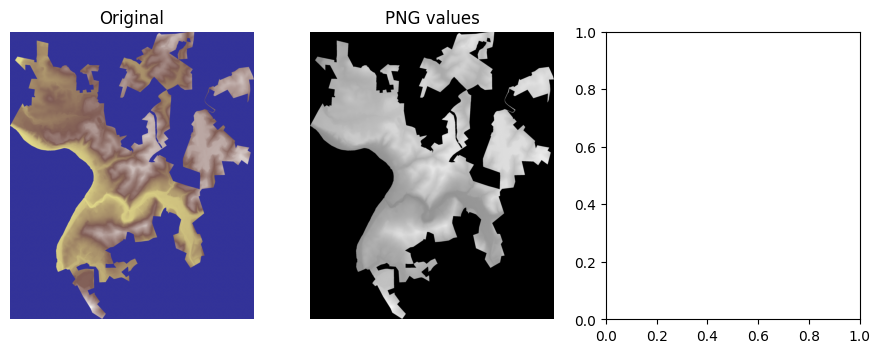

In [ ]:
# ============================================
# Verify that 16‑bit PNG preserves elevations
# ============================================
import rasterio
import numpy as np
from PIL import Image
from pathlib import Path

tif_path  = clipped_path
png16_path = Path("/content") / f"{tif_path.stem}_16bit.png"

# ── original DEM ───────────────────────────────────────────
with rasterio.open(tif_path) as src:
    dem_orig = src.read(1).astype(np.float32)
    nodata   = src.nodata

mask = (dem_orig == nodata)                # True where nodata
valid_orig = dem_orig[~mask]               # 1‑D view of valid heights
z_min, z_max = valid_orig.min(), valid_orig.max()

# ── read PNG & convert back to metres ─────────────────────
png = np.array(Image.open(png16_path)).astype(np.float32)
scale = png / 65535.0                      # 0–1
dem_recon = scale * (z_max - z_min) + z_min

# ── error metrics (only valid pixels) ─────────────────────
diff  = dem_recon[~mask] - valid_orig      # both 1‑D
rmse  = np.sqrt((diff**2).mean())
pct95 = np.percentile(np.abs(diff), 95)

print(f"RMSE   : {rmse:.3f} m")
print(f"95 % Δ : ≤ {pct95:.3f} m")

# ── quick visual sanity check ─────────────────────────────
import matplotlib.pyplot as plt
plt.figure(figsize=(9,3.5))
plt.subplot(1,3,1); plt.imshow(dem_orig , cmap='terrain'); plt.title("Original"); plt.axis("off")
plt.subplot(1,3,2); plt.imshow(png     , cmap='gray');    plt.title("PNG values"); plt.axis("off")
plt.subplot(1,3,3)
#plt.imshow(diff.reshape(dem_orig[~mask].shape))  # or replace reshape with alternative

plt.tight_layout(); plt.show()
